# Mini Project - USDA Food Composition
Team 9 

resources:

[Data](https://drive.google.com/open?id=1ZSeFZs4PijD1dF6fFw_mYUAUsPawaEmU)

[Instructions](https://docs.google.com/document/d/180S9oUpU1teR5BFXOQArYaC824uDKkXj7bnS3TZAcQw/edit)

# Step 1: Data Familiarization

Read the documentation to familiarize with the content:

https://fdc.nal.usda.gov/data-documentation.html

* What is this data about?
* What kind of information does it contain? 
* What is the meaning of this information? 
* How is the data structured? 
* What fields will I need to use? 
* What is their meaning? 
* How are the variables distributed?


In [70]:
import pandas as pd
import altair as alt
import numpy as np
alt.data_transformers.disable_max_rows()
# from google.colab import drive
# drive.mount('/content/drive', force_remount=True)

DataTransformerRegistry.enable('default')

In [206]:
data_df = pd.read_csv('usda-grp-nomiss.csv', delimiter=',')
data_df.head()

,Unnamed: 0,NDB_No,FdGrp_CD,FdGrp_Desc,Shrt_Desc,Water,Energ_Kcal,Protein,Lipid_Tot,Ash,...,Vit_K,FA_Sat,FA_Mono,FA_Poly,Cholestrl,GmWt_1,GmWt_Desc1,GmWt_2,GmWt_Desc2,Refuse_Pct
0,1,1001,100,Dairy and Egg Products,"BUTTER,WITH SALT",15.87,717,0.85,81.11,2.11,...,7.0,51.368,21.021,3.043,215,227.00,1 cup,14.2,1 tbsp,0
1,2,1002,100,Dairy and Egg Products,"BUTTER,WHIPPED,WITH SALT",15.87,717,0.85,81.11,2.11,...,7.0,50.489,23.426,3.012,219,151.00,1 cup,9.4,1 tbsp,0
2,3,1003,100,Dairy and Egg Products,"BUTTER OIL,ANHYDROUS",0.24,876,0.28,99.48,0.00,...,8.6,61.924,28.732,3.694,256,205.00,1 cup,12.8,1 tbsp,0
3,4,1004,100,Dairy and Egg Products,"CHEESE,BLUE",42.41,353,21.40,28.74,5.11,...,2.4,18.669,7.778,0.800,75,28.35,1 oz,17.0,1 cubic inch,0
4,5,1005,100,Dairy and Egg Products,"CHEESE,BRICK",41.11,371,23.24,29.68,3.18,...,2.5,18.764,8.598,0.784,94,132.00,"1 cup, diced",113.0,"1 cup, shredded",0


In [207]:
cols=[ 'Protein', 'Lipid_Tot', 'Ash', 'Carbohydrt', 'Fiber_TD',\
       'Sugar_Tot', 'Calcium', 'Iron', 'Magnesium', 'Phosphorus', 'Potassium',\
       'Sodium', 'Zinc', 'Copper', 'Manganese', 'Selenium', 'Vit_C', 'Thiamin',\
       'Riboflavin', 'Niacin', 'Panto_Acid', 'Vit_B6', 'Folate_Tot.',\
       'Folic_Acid', 'Food_Folate', 'Folate_DFE', 'Choline_Tot', 'Vit_B12',\
       'Vit_A_IU', 'Vit_A_RAE', 'Retinol', 'Alpha_Carot', 'Beta_Carot',\
       'Beta_Crypt', 'Lycopene', 'Lut.Zea', 'Vit_E', 'Vit_D', 'Vit_D.1',\
       'Vit_K', 'FA_Sat', 'FA_Mono', 'FA_Poly', 'Cholestrl', 'GmWt_1',\
       'GmWt_Desc1', 'GmWt_2', 'GmWt_Desc2', 'Refuse_Pct']


In [208]:
processed = data_df[cols].apply(pd.to_numeric, errors="coerce")
processed = processed.replace(np.nan, 0)

# Step 2: Answer Data Questions

# Set 2

Repeat the same 4 steps outlined above focusing on the following subsets of variables:
All the macronutrients
All the vitamins
All the minerals


## Analysis for All Vitamins :

In [174]:
vit_cols=[ 'Folate_Tot.','Folic_Acid','Food_Folate','Folate_DFE','Choline_Tot','Vit_C','Vit_B6','Vit_B12','Vit_A_IU', 'Vit_A_RAE','Vit_E', 'Vit_D', 'Vit_D.1',\
       'Vit_K','Retinol','Alpha_Carot','Beta_Carot','Beta_Crypt','Lycopene','Lut.Zea','Niacin','Riboflavin','Thiamin']    
vit_cols

['Folate_Tot.',
 'Folic_Acid',
 'Food_Folate',
 'Folate_DFE',
 'Choline_Tot',
 'Vit_C',
 'Vit_B6',
 'Vit_B12',
 'Vit_A_IU',
 'Vit_A_RAE',
 'Vit_E',
 'Vit_D',
 'Vit_D.1',
 'Vit_K',
 'Retinol',
 'Alpha_Carot',
 'Beta_Carot',
 'Beta_Crypt',
 'Lycopene',
 'Lut.Zea',
 'Niacin',
 'Riboflavin',
 'Thiamin']

### Clustering:

In [75]:
#Run PCA for dimensionality reduction 

from sklearn.decomposition import PCA
pca = PCA(n_components=2)

''' prepare the features for be analyszed '''
X = processed[vit_cols].values

''' find the first two principal components '''
reduced_data = pca.fit_transform(X)
# reduced_data

In [76]:
rd = pd.DataFrame(data=reduced_data, columns=['x', 'y'])
alt.Chart(rd).mark_point().encode(
    x='x:Q',
    y='y:Q'
)

alt.Chart(...)

In [77]:
#Run Tsne :
from sklearn.manifold import TSNE

In [78]:
result_tsne = TSNE(n_components=2).fit_transform(X)

tsne_df = pd.DataFrame(data=result_tsne, columns=['x','y'])

alt.Chart(tsne_df).mark_point().encode(
    x='x:Q',
    y='y:Q',
)

alt.Chart(...)

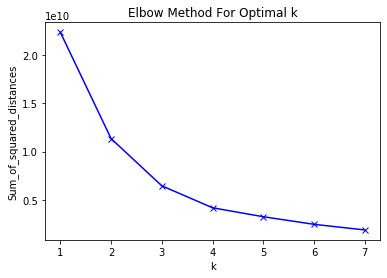

In [79]:
#Use Elbow method to decide the clusters 
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

Sum_of_squared_distances = []
K = range(1,8)
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(rd)
    Sum_of_squared_distances.append(km.inertia_)

plt.plot(K, Sum_of_squared_distances, 'bx-')
plt.xlabel('k')
plt.ylabel('Sum_of_squared_distances')
plt.title('Elbow Method For Optimal k')
plt.show()

In [ ]:
#Running K-means on PCA reduced data:
kmeans = KMeans(n_clusters=10)
model= kmeans.fit(rd)
labels = kmeans.predict(rd)

centers = model.cluster_centers_


In [ ]:
#adding the cluster column in data
rd.insert(2, "clusterlabel", labels, True)
rd

In [ ]:
#Plotting the vitamin data after PCA
points = alt.Chart(rd).mark_point().encode(
    x='x:Q',
    y='y:Q',
    color='clusterlabel:N'
)

points

In [80]:
#Running K-means on T-SNE reduced data:
kmeans = KMeans(n_clusters=12)
model= kmeans.fit(tsne_df)
labels_tsne = kmeans.predict(tsne_df)

centers_tsne = model.cluster_centers_

In [81]:
#adding the cluster column in data
tsne_df.insert(2, "clusterlabel", labels_tsne, True)
tsne_df

,x,y,clusterlabel
0,-13.481683,-44.537640,6
1,-13.481652,-44.537674,6
2,-12.885220,-45.504986,6
3,-15.964272,-32.461342,3
4,-16.586214,-37.721752,3
...,...,...,...
1831,2.288060,-20.036240,10
1832,11.435201,28.937805,4
1833,23.944778,25.766336,4
1834,16.926006,22.683842,4


In [82]:
#Plotting the vitamin data after PCA
points = alt.Chart(tsne_df).mark_point().encode(
    x='x:Q',
    y='y:Q',
    color=alt.Color('clusterlabel:O', scale=alt.Scale(scheme='paired'))
)

points

alt.Chart(...)

### Cluster vs Labels:

##### Question : Do food belonging to the same food group fall in the same clusters? 


In [175]:
#Plotting clusters according to food group for vitamins afte TSNE
data_vitamins = data_df.copy()
data_vitamins.insert(2, "clusterlabel", labels_tsne, True)

In [176]:
foodgroupcluster_vitamin = data_vitamins.groupby('FdGrp_Desc')['clusterlabel'].value_counts()
foodgroupcluster_vitamin

FdGrp_Desc                         clusterlabel
Baby Foods                         6               17
                                   1                7
                                   10               7
                                   0                6
                                   8                4
                                                   ..
Vegetables and Vegetable Products  7               15
                                   9               15
                                   0                8
                                   11               3
                                   2                1
Name: clusterlabel, Length: 151, dtype: int64

In [177]:
vit=alt.Chart(data_vitamins).mark_bar().encode(
    x=alt.X('FdGrp_Desc', sort='-y'),
    y=alt.Y('count(clusterlabel)', stack="normalize"),
    color='clusterlabel:N'
)
vit

alt.Chart(...)

In [178]:
# foodgroupcluster_vitamin = data_vitamins.groupby(['clusterlabel','FdGrp_Desc']).value_counts()
foodgroupcluster_vitamin=data_vitamins.groupby(['clusterlabel', 'FdGrp_Desc']).size().to_frame('counts').reset_index()
foodgroupcluster_vitamin=foodgroupcluster_vitamin.reset_index()
foodgroupcluster_vitamin.columns

Index(['index', 'clusterlabel', 'FdGrp_Desc', 'counts'], dtype='object')

In [179]:
 alt.Chart(foodgroupcluster_vitamin).mark_circle().encode(
    x = alt.X('FdGrp_Desc:N'),
    y = alt.Y('clusterlabel:N'),
    size=alt.Size('counts:Q',scale=alt.Scale(domain=[0,40])),
    opacity=alt.value(0.4),
    color=alt.value('red'),
    tooltip=['FdGrp_Desc']
).properties(
    width=500,
    height=400,
    title='Foodgroups in clusters'
).configure_axis(
    grid=True
)

alt.Chart(...)

### Interpretation:

##### Are there foods that belong to the same food group but fall into different clusters (that is, same food group but different food composition)?

In [180]:
data_vitamins_processed=data_vitamins[vit_cols].apply(pd.to_numeric, errors="coerce")
data_vitamins_processed = data_vitamins_processed.replace(np.nan,0)
data_vitamins_processed.head()

,Folate_Tot.,Folic_Acid,Food_Folate,Folate_DFE,Choline_Tot,Vit_C,Vit_B6,Vit_B12,Vit_A_IU,Vit_A_RAE,...,Vit_K,Retinol,Alpha_Carot,Beta_Carot,Beta_Crypt,Lycopene,Lut.Zea,Niacin,Riboflavin,Thiamin
0,3,0,3,3,18.8,0.0,0.003,0.17,2499,684,...,7.0,671,0,158,0,0,0,0.042,0.034,0.005
1,3,0,3,3,18.8,0.0,0.003,0.13,2499,684,...,7.0,671,0,158,0,0,0,0.042,0.034,0.005
2,0,0,0,0,22.3,0.0,0.001,0.01,3069,840,...,8.6,824,0,193,0,0,0,0.003,0.005,0.001
3,36,0,36,36,15.4,0.0,0.166,1.22,763,198,...,2.4,192,0,74,0,0,0,1.016,0.382,0.029
4,20,0,20,20,15.4,0.0,0.065,1.26,1080,292,...,2.5,286,0,76,0,0,0,0.118,0.351,0.014


In [181]:
from sklearn import preprocessing
x = data_vitamins_processed.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
vit_normalized_df = pd.DataFrame(x_scaled)

vit_normalized_df = pd.DataFrame(x_scaled, columns = data_vitamins_processed.columns)

In [182]:
#Normalize the data before pdp plot
wide_form = vit_normalized_df.reset_index().rename(columns={'index':'id'})
wide_form.head()


,id,Folate_Tot.,Folic_Acid,Food_Folate,Folate_DFE,Choline_Tot,Vit_C,Vit_B6,Vit_B12,Vit_A_IU,...,Vit_K,Retinol,Alpha_Carot,Beta_Carot,Beta_Crypt,Lycopene,Lut.Zea,Niacin,Riboflavin,Thiamin
0,0,0.001282,0.0,0.001282,0.001282,0.007823,0.0,0.000509,0.008462,0.050737,...,0.004083,0.159005,0.0,0.006039,0.0,0.0,0.0,0.000825,0.008273,0.000455
1,1,0.001282,0.0,0.001282,0.001282,0.007823,0.0,0.000509,0.006471,0.050737,...,0.004083,0.159005,0.0,0.006039,0.0,0.0,0.0,0.000825,0.008273,0.000455
2,2,0.000000,0.0,0.000000,0.000000,0.009279,0.0,0.000170,0.000498,0.062310,...,0.005016,0.195261,0.0,0.007377,0.0,0.0,0.0,0.000059,0.001217,0.000091
3,3,0.015385,0.0,0.015385,0.015385,0.006408,0.0,0.028140,0.060727,0.015491,...,0.001400,0.045498,0.0,0.002829,0.0,0.0,0.0,0.019946,0.092944,0.002639
4,4,0.008547,0.0,0.008547,0.008547,0.006408,0.0,0.011019,0.062718,0.021927,...,0.001458,0.067773,0.0,0.002905,0.0,0.0,0.0,0.002317,0.085401,0.001274


In [183]:
wide_form.insert(2, "clusterlabel", labels_tsne, True)
wide_form.columns

Index(['id', 'Folate_Tot.', 'clusterlabel', 'Folic_Acid', 'Food_Folate',
       'Folate_DFE', 'Choline_Tot', 'Vit_C', 'Vit_B6', 'Vit_B12', 'Vit_A_IU',
       'Vit_A_RAE', 'Vit_E', 'Vit_D', 'Vit_D.1', 'Vit_K', 'Retinol',
       'Alpha_Carot', 'Beta_Carot', 'Beta_Crypt', 'Lycopene', 'Lut.Zea',
       'Niacin', 'Riboflavin', 'Thiamin'],
      dtype='object')

In [184]:
wide_form = wide_form.groupby('clusterlabel').median().reset_index()
to_plot = pd.melt(wide_form,id_vars=['id','clusterlabel'],var_name='metrics', value_name='values')

to_plot

,id,clusterlabel,metrics,values
0,472.0,0,Folate_Tot.,0.002991
1,864.5,1,Folate_Tot.,0.004915
2,1266.0,2,Folate_Tot.,0.004274
3,240.5,3,Folate_Tot.,0.006197
4,1130.5,4,Folate_Tot.,0.000000
...,...,...,...,...
271,390.5,7,Thiamin,0.003185
272,439.0,8,Thiamin,0.007006
273,1254.0,9,Thiamin,0.017561
274,708.5,10,Thiamin,0.005050


In [93]:
#new graph across vitamins
#cluster wise spread of nutrients (by median value )
alt.Chart(to_plot).mark_line().encode(
    x='metrics:N',
    y='values:Q',
    color=alt.Color('clusterlabel:O', scale=alt.Scale(scheme='paired'))
).properties(width=1000, height=300*2)

alt.Chart(...)

In [209]:
#Plotting the PDP by foodgroup - cluster wise and foodgroup spread of nutrients
pdp_data = data_df.copy()
pdp_data.head()

,Unnamed: 0,NDB_No,FdGrp_CD,FdGrp_Desc,Shrt_Desc,Water,Energ_Kcal,Protein,Lipid_Tot,Ash,...,Vit_K,FA_Sat,FA_Mono,FA_Poly,Cholestrl,GmWt_1,GmWt_Desc1,GmWt_2,GmWt_Desc2,Refuse_Pct
0,1,1001,100,Dairy and Egg Products,"BUTTER,WITH SALT",15.87,717,0.85,81.11,2.11,...,7.0,51.368,21.021,3.043,215,227.00,1 cup,14.2,1 tbsp,0
1,2,1002,100,Dairy and Egg Products,"BUTTER,WHIPPED,WITH SALT",15.87,717,0.85,81.11,2.11,...,7.0,50.489,23.426,3.012,219,151.00,1 cup,9.4,1 tbsp,0
2,3,1003,100,Dairy and Egg Products,"BUTTER OIL,ANHYDROUS",0.24,876,0.28,99.48,0.00,...,8.6,61.924,28.732,3.694,256,205.00,1 cup,12.8,1 tbsp,0
3,4,1004,100,Dairy and Egg Products,"CHEESE,BLUE",42.41,353,21.40,28.74,5.11,...,2.4,18.669,7.778,0.800,75,28.35,1 oz,17.0,1 cubic inch,0
4,5,1005,100,Dairy and Egg Products,"CHEESE,BRICK",41.11,371,23.24,29.68,3.18,...,2.5,18.764,8.598,0.784,94,132.00,"1 cup, diced",113.0,"1 cup, shredded",0


In [ ]:
#normalize data for pdp
cols_to_norm = ['Water','Energ_Kcal','Protein', 'Lipid_Tot', 'Ash', 'Carbohydrt', 'Fiber_TD',\
       'Sugar_Tot', 'Calcium', 'Iron', 'Magnesium', 'Phosphorus', 'Potassium',\
       'Sodium', 'Zinc', 'Copper', 'Manganese', 'Selenium', 'Vit_C', 'Thiamin',\
       'Riboflavin', 'Niacin', 'Panto_Acid', 'Vit_B6', 'Folate_Tot.',\
       'Folic_Acid', 'Food_Folate', 'Folate_DFE', 'Choline_Tot', 'Vit_B12',\
       'Vit_A_IU', 'Vit_A_RAE', 'Retinol', 'Alpha_Carot', 'Beta_Carot',\
       'Beta_Crypt', 'Lycopene', 'Lut.Zea', 'Vit_E', 'Vit_D', 'Vit_D.1',\
       'Vit_K', 'FA_Sat', 'FA_Mono', 'FA_Poly', 'Cholestrl', 'GmWt_1',\
       'GmWt_Desc1', 'GmWt_2', 'GmWt_Desc2', 'Refuse_Pct']
#x = pdp_data[cols].values #retu
pdp_data=pdp_data[cols_to_norm].apply(pd.to_numeric, errors="coerce")
pdp_data = pdp_data.replace(np.nan,0)

x=pdp_data[cols_to_norm].values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
pdp_data_normalized = pd.DataFrame(x_scaled)
pdp_data_normalized_df = pd.DataFrame(x_scaled, columns = pdp_data.columns)
#pdp_data_normalized_df['FdGrp_CD'] = data_df['FdGrp_CD']
pdp_data_normalized_df['FdGrp_Desc'] = data_df['FdGrp_Desc']
pdp_data_normalized_df['Shrt_Desc'] = data_df['Shrt_Desc']
pdp_data_normalized_df.head()

In [210]:
#normalize data for pdp - vitamins

#x = pdp_data[cols].values #retu
pdp_data=pdp_data[vit_cols].apply(pd.to_numeric, errors="coerce")
pdp_data = pdp_data.replace(np.nan,0)

x=pdp_data[vit_cols].values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
pdp_data_normalized = pd.DataFrame(x_scaled)
pdp_data_normalized_df = pd.DataFrame(x_scaled, columns = pdp_data.columns)
#pdp_data_normalized_df['FdGrp_CD'] = data_df['FdGrp_CD']
pdp_data_normalized_df['FdGrp_Desc'] = data_df['FdGrp_Desc']
pdp_data_normalized_df['Shrt_Desc'] = data_df['Shrt_Desc']
pdp_data_normalized_df.head()

,Folate_Tot.,Folic_Acid,Food_Folate,Folate_DFE,Choline_Tot,Vit_C,Vit_B6,Vit_B12,Vit_A_IU,Vit_A_RAE,...,Alpha_Carot,Beta_Carot,Beta_Crypt,Lycopene,Lut.Zea,Niacin,Riboflavin,Thiamin,FdGrp_Desc,Shrt_Desc
0,0.001282,0.0,0.001282,0.001282,0.007823,0.0,0.000509,0.008462,0.050737,0.162085,...,0.0,0.006039,0.0,0.0,0.0,0.000825,0.008273,0.000455,Dairy and Egg Products,"BUTTER,WITH SALT"
1,0.001282,0.0,0.001282,0.001282,0.007823,0.0,0.000509,0.006471,0.050737,0.162085,...,0.0,0.006039,0.0,0.0,0.0,0.000825,0.008273,0.000455,Dairy and Egg Products,"BUTTER,WHIPPED,WITH SALT"
2,0.000000,0.0,0.000000,0.000000,0.009279,0.0,0.000170,0.000498,0.062310,0.199052,...,0.0,0.007377,0.0,0.0,0.0,0.000059,0.001217,0.000091,Dairy and Egg Products,"BUTTER OIL,ANHYDROUS"
3,0.015385,0.0,0.015385,0.015385,0.006408,0.0,0.028140,0.060727,0.015491,0.046919,...,0.0,0.002829,0.0,0.0,0.0,0.019946,0.092944,0.002639,Dairy and Egg Products,"CHEESE,BLUE"
4,0.008547,0.0,0.008547,0.008547,0.006408,0.0,0.011019,0.062718,0.021927,0.069194,...,0.0,0.002905,0.0,0.0,0.0,0.002317,0.085401,0.001274,Dairy and Egg Products,"CHEESE,BRICK"


In [211]:
pdp_data_normalized_df.insert(2, "clusterlabel", labels_tsne, True)
pdp_data_normalized_df.head()

,Folate_Tot.,Folic_Acid,clusterlabel,Food_Folate,Folate_DFE,Choline_Tot,Vit_C,Vit_B6,Vit_B12,Vit_A_IU,...,Alpha_Carot,Beta_Carot,Beta_Crypt,Lycopene,Lut.Zea,Niacin,Riboflavin,Thiamin,FdGrp_Desc,Shrt_Desc
0,0.001282,0.0,6,0.001282,0.001282,0.007823,0.0,0.000509,0.008462,0.050737,...,0.0,0.006039,0.0,0.0,0.0,0.000825,0.008273,0.000455,Dairy and Egg Products,"BUTTER,WITH SALT"
1,0.001282,0.0,6,0.001282,0.001282,0.007823,0.0,0.000509,0.006471,0.050737,...,0.0,0.006039,0.0,0.0,0.0,0.000825,0.008273,0.000455,Dairy and Egg Products,"BUTTER,WHIPPED,WITH SALT"
2,0.000000,0.0,6,0.000000,0.000000,0.009279,0.0,0.000170,0.000498,0.062310,...,0.0,0.007377,0.0,0.0,0.0,0.000059,0.001217,0.000091,Dairy and Egg Products,"BUTTER OIL,ANHYDROUS"
3,0.015385,0.0,3,0.015385,0.015385,0.006408,0.0,0.028140,0.060727,0.015491,...,0.0,0.002829,0.0,0.0,0.0,0.019946,0.092944,0.002639,Dairy and Egg Products,"CHEESE,BLUE"
4,0.008547,0.0,3,0.008547,0.008547,0.006408,0.0,0.011019,0.062718,0.021927,...,0.0,0.002905,0.0,0.0,0.0,0.002317,0.085401,0.001274,Dairy and Egg Products,"CHEESE,BRICK"


In [212]:

wide_form = pdp_data_normalized_df.reset_index().rename(columns={'index':'id'})
wide_form.head()
# convert from wide-form to long-form directly
to_plot = pd.melt(wide_form,id_vars=['id','clusterlabel','FdGrp_Desc','Shrt_Desc'],var_name='metrics', value_name='values')

to_plot.shape

(42228, 6)

###### Are there any foods that tend to be different from all the others (that is, they are outliers)? What is unique about them? What makes them unique?For the clusters and outliers identified above, what aspects of their food composition make them different from the others and similar to the food that belong to the same cluster (that is, what makes a cluster (or outlier) unique in terms of their data values and distribution and how does it compare to the other clusters)?


In [ ]:
#cluster wise spread of nutrients for each foodgroup by vitamins

alt.Chart(to_plot).mark_line(
    opacity = 0.2,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'FdGrp_Desc:O',
    color=alt.Color('clusterlabel:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

In [213]:
to_plot.head()

,id,clusterlabel,FdGrp_Desc,Shrt_Desc,metrics,values
0,0,6,Dairy and Egg Products,"BUTTER,WITH SALT",Folate_Tot.,0.001282
1,1,6,Dairy and Egg Products,"BUTTER,WHIPPED,WITH SALT",Folate_Tot.,0.001282
2,2,6,Dairy and Egg Products,"BUTTER OIL,ANHYDROUS",Folate_Tot.,0.000000
3,3,3,Dairy and Egg Products,"CHEESE,BLUE",Folate_Tot.,0.015385
4,4,3,Dairy and Egg Products,"CHEESE,BRICK",Folate_Tot.,0.008547


In [214]:
new_df = to_plot.copy()
cluster10_df = new_df.loc[new_df['clusterlabel']==10]
cluster10_df.head()

,id,clusterlabel,FdGrp_Desc,Shrt_Desc,metrics,values
54,54,10,Dairy and Egg Products,"DESSERT TOPPING,SEMI SOLID,FRZ",Folate_Tot.,0.000000
86,86,10,Dairy and Egg Products,"EGG,WHL,RAW,FRSH",Folate_Tot.,0.020085
89,89,10,Dairy and Egg Products,"EGG,WHL,CKD,HARD-BOILED",Folate_Tot.,0.018803
90,90,10,Dairy and Egg Products,"EGG,WHOLE,COOKED,OMELET",Folate_Tot.,0.016667
91,91,10,Dairy and Egg Products,"EGG,WHL,CKD,SCRMBLD",Folate_Tot.,0.015385


In [216]:
alt.Chart(cluster10_df).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    #row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [192]:
cluster0_df = new_df.loc[new_df['clusterlabel']==0]
cluster0_df.head()

,id,clusterlabel,FdGrp_Desc,metrics,values
9,9,0,Dairy and Egg Products,Folate_Tot.,0.005128
10,10,0,Dairy and Egg Products,Folate_Tot.,0.004701
12,12,0,Dairy and Egg Products,Folate_Tot.,0.004274
13,13,0,Dairy and Egg Products,Folate_Tot.,0.005128
46,46,0,Dairy and Egg Products,Folate_Tot.,0.000427


In [193]:
alt.Chart(cluster0_df).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    #row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [203]:
cluster1_df = new_df.loc[new_df['clusterlabel']==1]
cluster1_df.head()
alt.Chart(cluster1_df).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [195]:
cluster2_df = new_df.loc[new_df['clusterlabel']==2]
cluster2_df.head()
alt.Chart(cluster2_df).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    #row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [196]:
cluster3_df = new_df.loc[new_df['clusterlabel']==3]
cluster3_df.head()
alt.Chart(cluster3_df).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [197]:
cluster4_df = new_df.loc[new_df['clusterlabel']==4]
cluster4_df.head()
alt.Chart(cluster4_df).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [205]:
cluster5_df = new_df.loc[new_df['clusterlabel']==5]
cluster5_df.head()
alt.Chart(cluster5_df).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [199]:
cluster6_df = new_df.loc[new_df['clusterlabel']==6]
cluster6_df.head()
alt.Chart(cluster6_df).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    #row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [200]:
cluster7_df = new_df.loc[new_df['clusterlabel']==7]
cluster7_df.head()
alt.Chart(cluster7_df).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    #row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [204]:
cluster8_df = new_df.loc[new_df['clusterlabel']==8]
cluster8_df.head()
alt.Chart(cluster8_df).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [202]:
cluster9_df = new_df.loc[new_df['clusterlabel']==9]
cluster9_df.head()
alt.Chart(cluster9_df).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    #row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [31]:
#cluster wise spread of nutrients for each foodgroup by cluster and color - foodgroup

alt.Chart(to_plot).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme=''))
).properties(width=500*2,
    height=100)

alt.Chart(...)

## Analysis for Minerals :

In [262]:
minerals_cols=['Calcium', 'Iron', 'Magnesium', 'Phosphorus', 'Potassium','Sodium', 'Zinc', 'Copper', 'Manganese', 'Selenium','Ash']    
minerals_cols

['Calcium',
 'Iron',
 'Magnesium',
 'Phosphorus',
 'Potassium',
 'Sodium',
 'Zinc',
 'Copper',
 'Manganese',
 'Selenium',
 'Ash']

In [99]:
X_minerals = processed[minerals_cols].values
result_tsne_mineral = TSNE(n_components=2).fit_transform(X_minerals)

tsne_df_mineral = pd.DataFrame(data=result_tsne_mineral, columns=['x','y'])

alt.Chart(tsne_df_mineral).mark_point().encode(
    x='x:Q',
    y='y:Q',
)

alt.Chart(...)

### Clustering:

In [100]:
kmeans = KMeans(n_clusters=12)
model= kmeans.fit(tsne_df_mineral)
labels_tsne_mineral = kmeans.predict(tsne_df_mineral)

centers_tsne_mineral = model.cluster_centers_

In [101]:
#adding the cluster column in data
tsne_df_mineral.insert(2, "clusterlabel", labels_tsne_mineral, True)
#tsne_df_mineral
points = alt.Chart(tsne_df_mineral).mark_point().encode(
    x='x:Q',
    y='y:Q',
    color=alt.Color('clusterlabel:N', scale=alt.Scale(scheme='paired'))
)

points

alt.Chart(...)

### Clusters vs labels

In [263]:
#Plotting clusters according to food group for minerals afte TSNE
data_minerals = data_df.copy()
data_minerals.insert(2, "clusterlabel", labels_tsne_mineral, True)
data_minerals.columns

Index(['Unnamed: 0', 'NDB_No', 'clusterlabel', 'FdGrp_CD', 'FdGrp_Desc',
       'Shrt_Desc', 'Water', 'Energ_Kcal', 'Protein', 'Lipid_Tot', 'Ash',
       'Carbohydrt', 'Fiber_TD', 'Sugar_Tot', 'Calcium', 'Iron', 'Magnesium',
       'Phosphorus', 'Potassium', 'Sodium', 'Zinc', 'Copper', 'Manganese',
       'Selenium', 'Vit_C', 'Thiamin', 'Riboflavin', 'Niacin', 'Panto_Acid',
       'Vit_B6', 'Folate_Tot.', 'Folic_Acid', 'Food_Folate', 'Folate_DFE',
       'Choline_Tot', 'Vit_B12', 'Vit_A_IU', 'Vit_A_RAE', 'Retinol',
       'Alpha_Carot', 'Beta_Carot', 'Beta_Crypt', 'Lycopene', 'Lut.Zea',
       'Vit_E', 'Vit_D', 'Vit_D.1', 'Vit_K', 'FA_Sat', 'FA_Mono', 'FA_Poly',
       'Cholestrl', 'GmWt_1', 'GmWt_Desc1', 'GmWt_2', 'GmWt_Desc2',
       'Refuse_Pct'],
      dtype='object')

In [103]:
minerals=alt.Chart(data_minerals).mark_bar().encode(
    x=alt.X('FdGrp_Desc', sort='-y'),
    y=alt.Y('count(clusterlabel)', stack="normalize"),
    color='clusterlabel:N'
)
minerals

alt.Chart(...)

In [104]:
foodgroupcluster_minerals=data_minerals.groupby(['clusterlabel', 'FdGrp_Desc']).size().to_frame('counts').reset_index()
foodgroupcluster_minerals=foodgroupcluster_minerals.reset_index()
foodgroupcluster_minerals.columns

Index(['index', 'clusterlabel', 'FdGrp_Desc', 'counts'], dtype='object')

In [105]:
 alt.Chart(foodgroupcluster_minerals).mark_circle().encode(
    x = alt.X('FdGrp_Desc:N'),
    y = alt.Y('clusterlabel:N'),
    size=alt.Size('counts:Q',scale=alt.Scale(domain=[0,40])),
    opacity=alt.value(0.4),
    color=alt.value('red'),
    tooltip=['FdGrp_Desc']
).properties(
    width=500,
    height=400,
    title='Foodgroups in clusters'
).configure_axis(
    grid=True
)

alt.Chart(...)

### Interpretation

In [264]:
data_minerals_processed=data_minerals[minerals_cols].apply(pd.to_numeric, errors="coerce")
data_minerals_processed = data_minerals_processed.replace(np.nan,0)
data_minerals_processed.head()

,Calcium,Iron,Magnesium,Phosphorus,Potassium,Sodium,Zinc,Copper,Manganese,Selenium,Ash
0,24,0.02,2,24,24,714,0.09,0.000,0.000,1.0,2.11
1,24,0.16,2,23,26,827,0.05,0.016,0.004,1.0,2.11
2,4,0.00,0,3,5,2,0.01,0.001,0.000,0.0,0.00
3,528,0.31,23,387,256,1395,2.66,0.040,0.009,14.5,5.11
4,674,0.43,24,451,136,560,2.60,0.024,0.012,14.5,3.18


In [231]:
#Normalize the data before pdp plot
x_min = data_minerals_processed.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled_min = min_max_scaler.fit_transform(x_min)
min_normalized_df = pd.DataFrame(x_scaled_min)

min_normalized_df = pd.DataFrame(x_scaled_min, columns = data_minerals_processed.columns)
min_normalized_df.head()

,Calcium,Iron,Magnesium,Phosphorus,Potassium,Sodium,Zinc,Copper,Manganese,Selenium,Ash
0,0.003259,0.000223,0.002813,0.002420,0.001455,0.018422,0.000990,0.000000,0.000000,0.000522,0.021142
1,0.003259,0.001782,0.002813,0.002319,0.001576,0.021338,0.000550,0.002623,0.000067,0.000522,0.021142
2,0.000543,0.000000,0.000000,0.000302,0.000303,0.000052,0.000110,0.000164,0.000000,0.000000,0.000000
3,0.071700,0.003452,0.032349,0.039020,0.015515,0.035993,0.029247,0.006557,0.000150,0.007564,0.051202
4,0.091526,0.004788,0.033755,0.045473,0.008242,0.014449,0.028587,0.003934,0.000200,0.007564,0.031864


In [232]:
wide_form_min = min_normalized_df.reset_index().rename(columns={'index':'id'})
wide_form_min.insert(2, "clusterlabel", labels_tsne_mineral, True)
wide_form_min.columns

Index(['id', 'Calcium', 'clusterlabel', 'Iron', 'Magnesium', 'Phosphorus',
       'Potassium', 'Sodium', 'Zinc', 'Copper', 'Manganese', 'Selenium',
       'Ash'],
      dtype='object')

In [109]:
wide_form_min = wide_form_min.groupby('clusterlabel').median().reset_index()
to_plot_min = pd.melt(wide_form_min,id_vars=['id','clusterlabel'],var_name='metrics', value_name='values')

to_plot_min

,id,clusterlabel,metrics,values
0,654.0,0,Calcium,0.003123
1,97.0,1,Calcium,0.016567
2,1161.0,2,Calcium,0.002173
3,917.5,3,Calcium,0.003123
4,449.0,4,Calcium,0.001765
...,...,...,...,...
127,1396.0,7,Ash,0.020641
128,988.0,8,Ash,0.036072
129,818.0,9,Ash,0.011323
130,1115.5,10,Ash,0.001002


In [110]:
#new chart across minerals
alt.Chart(to_plot_min).mark_line().encode(
    x='metrics:N',
    y='values:Q',
    color=alt.Color('clusterlabel:N', scale=alt.Scale(scheme='paired'))
).properties(width=800, height=300*2)

alt.Chart(...)

In [265]:
#Plotting the PDP by foodgroup - cluster wise and foodgroup spread of nutrients
pdp_data_mineral = data_df.copy()
pdp_data_mineral.head()

,Unnamed: 0,NDB_No,FdGrp_CD,FdGrp_Desc,Shrt_Desc,Water,Energ_Kcal,Protein,Lipid_Tot,Ash,...,Vit_K,FA_Sat,FA_Mono,FA_Poly,Cholestrl,GmWt_1,GmWt_Desc1,GmWt_2,GmWt_Desc2,Refuse_Pct
0,1,1001,100,Dairy and Egg Products,"BUTTER,WITH SALT",15.87,717,0.85,81.11,2.11,...,7.0,51.368,21.021,3.043,215,227.00,1 cup,14.2,1 tbsp,0
1,2,1002,100,Dairy and Egg Products,"BUTTER,WHIPPED,WITH SALT",15.87,717,0.85,81.11,2.11,...,7.0,50.489,23.426,3.012,219,151.00,1 cup,9.4,1 tbsp,0
2,3,1003,100,Dairy and Egg Products,"BUTTER OIL,ANHYDROUS",0.24,876,0.28,99.48,0.00,...,8.6,61.924,28.732,3.694,256,205.00,1 cup,12.8,1 tbsp,0
3,4,1004,100,Dairy and Egg Products,"CHEESE,BLUE",42.41,353,21.40,28.74,5.11,...,2.4,18.669,7.778,0.800,75,28.35,1 oz,17.0,1 cubic inch,0
4,5,1005,100,Dairy and Egg Products,"CHEESE,BRICK",41.11,371,23.24,29.68,3.18,...,2.5,18.764,8.598,0.784,94,132.00,"1 cup, diced",113.0,"1 cup, shredded",0


In [266]:
pdp_data_mineral.columns

Index(['Unnamed: 0', 'NDB_No', 'FdGrp_CD', 'FdGrp_Desc', 'Shrt_Desc', 'Water',
       'Energ_Kcal', 'Protein', 'Lipid_Tot', 'Ash', 'Carbohydrt', 'Fiber_TD',
       'Sugar_Tot', 'Calcium', 'Iron', 'Magnesium', 'Phosphorus', 'Potassium',
       'Sodium', 'Zinc', 'Copper', 'Manganese', 'Selenium', 'Vit_C', 'Thiamin',
       'Riboflavin', 'Niacin', 'Panto_Acid', 'Vit_B6', 'Folate_Tot.',
       'Folic_Acid', 'Food_Folate', 'Folate_DFE', 'Choline_Tot', 'Vit_B12',
       'Vit_A_IU', 'Vit_A_RAE', 'Retinol', 'Alpha_Carot', 'Beta_Carot',
       'Beta_Crypt', 'Lycopene', 'Lut.Zea', 'Vit_E', 'Vit_D', 'Vit_D.1',
       'Vit_K', 'FA_Sat', 'FA_Mono', 'FA_Poly', 'Cholestrl', 'GmWt_1',
       'GmWt_Desc1', 'GmWt_2', 'GmWt_Desc2', 'Refuse_Pct'],
      dtype='object')

In [ ]:
#normalize data for pdp
cols_to_norm = ['Water','Energ_Kcal','Protein', 'Lipid_Tot', 'Ash', 'Carbohydrt', 'Fiber_TD',\
       'Sugar_Tot', 'Calcium', 'Iron', 'Magnesium', 'Phosphorus', 'Potassium',\
       'Sodium', 'Zinc', 'Copper', 'Manganese', 'Selenium', 'Vit_C', 'Thiamin',\
       'Riboflavin', 'Niacin', 'Panto_Acid', 'Vit_B6', 'Folate_Tot.',\
       'Folic_Acid', 'Food_Folate', 'Folate_DFE', 'Choline_Tot', 'Vit_B12',\
       'Vit_A_IU', 'Vit_A_RAE', 'Retinol', 'Alpha_Carot', 'Beta_Carot',\
       'Beta_Crypt', 'Lycopene', 'Lut.Zea', 'Vit_E', 'Vit_D', 'Vit_D.1',\
       'Vit_K', 'FA_Sat', 'FA_Mono', 'FA_Poly', 'Cholestrl', 'GmWt_1',\
       'GmWt_Desc1', 'GmWt_2', 'GmWt_Desc2', 'Refuse_Pct']
#x = pdp_data[cols].values #retu
pdp_data_mineral=pdp_data_mineral[cols_to_norm].apply(pd.to_numeric, errors="coerce")
pdp_data_mineral = pdp_data_mineral.replace(np.nan,0)

x_mineral=pdp_data_mineral[cols_to_norm].values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled_min = min_max_scaler.fit_transform(x_mineral)
pdp_data_normalized = pd.DataFrame(x_scaled_min)
pdp_data_normalized_df = pd.DataFrame(x_scaled_min, columns = pdp_data_mineral.columns)
#pdp_data_normalized_df['FdGrp_CD'] = data_df['FdGrp_CD']
pdp_data_normalized_df['FdGrp_Desc'] = data_df['FdGrp_Desc']
pdp_data_normalized_df['Shrt_Desc'] = data_df['Shrt_Desc']
pdp_data_normalized_df.head()

In [267]:
#normalize data for pdp

#x = pdp_data[cols].values #retu
pdp_data_mineral=pdp_data_mineral[minerals_cols].apply(pd.to_numeric, errors="coerce")
pdp_data_mineral = pdp_data_mineral.replace(np.nan,0)

x_mineral=pdp_data_mineral[minerals_cols].values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled_min = min_max_scaler.fit_transform(x_mineral)
pdp_data_normalized = pd.DataFrame(x_scaled_min)
pdp_data_normalized_df = pd.DataFrame(x_scaled_min, columns = pdp_data_mineral.columns)
#pdp_data_normalized_df['FdGrp_CD'] = data_df['FdGrp_CD']
pdp_data_normalized_df['FdGrp_Desc'] = data_df['FdGrp_Desc']
#pdp_data_normalized_df['Shrt_Desc'] = data_df['Shrt_Desc']
pdp_data_normalized_df.head()

,Calcium,Iron,Magnesium,Phosphorus,Potassium,Sodium,Zinc,Copper,Manganese,Selenium,Ash,FdGrp_Desc
0,0.003259,0.000223,0.002813,0.002420,0.001455,0.018422,0.000990,0.000000,0.000000,0.000522,0.021142,Dairy and Egg Products
1,0.003259,0.001782,0.002813,0.002319,0.001576,0.021338,0.000550,0.002623,0.000067,0.000522,0.021142,Dairy and Egg Products
2,0.000543,0.000000,0.000000,0.000302,0.000303,0.000052,0.000110,0.000164,0.000000,0.000000,0.000000,Dairy and Egg Products
3,0.071700,0.003452,0.032349,0.039020,0.015515,0.035993,0.029247,0.006557,0.000150,0.007564,0.051202,Dairy and Egg Products
4,0.091526,0.004788,0.033755,0.045473,0.008242,0.014449,0.028587,0.003934,0.000200,0.007564,0.031864,Dairy and Egg Products


In [268]:
pdp_data_normalized_df.insert(2, "clusterlabel", labels_tsne_mineral, True)
pdp_data_normalized_df.head()

wide_form = pdp_data_normalized_df.reset_index().rename(columns={'index':'id'})
wide_form.head()
# convert from wide-form to long-form directly
to_plot = pd.melt(wide_form,id_vars=['id','clusterlabel','FdGrp_Desc'],var_name='metrics', value_name='values')

to_plot.shape

(20196, 5)

In [ ]:
#cluster wise spread of nutrients for each foodgroup- across minerals content

alt.Chart(to_plot).mark_line(
    opacity = 0.2,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'FdGrp_Desc:O',
    color=alt.Color('clusterlabel:O', scale=alt.Scale(scheme='sinebow'))
).properties(width=500*2,
    height=100)

In [269]:
new_df_min = to_plot.copy()
cluster0_df_min = new_df_min.loc[new_df_min['clusterlabel']==0]
cluster0_df_min.head()
alt.Chart(cluster0_df_min).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [241]:
cluster1_df_min = new_df_min.loc[new_df_min['clusterlabel']==1]
cluster1_df_min.head()
alt.Chart(cluster1_df_min).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='paired'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [270]:
cluster3_df_min = new_df_min.loc[new_df_min['clusterlabel']==3]
cluster3_df_min.head()
alt.Chart(cluster3_df_min).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [271]:
cluster5_df_min = new_df_min.loc[new_df_min['clusterlabel']==5]
cluster5_df_min.head()
alt.Chart(cluster5_df_min).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [244]:
cluster4_df_min = new_df_min.loc[new_df_min['clusterlabel']==4]
cluster4_df_min.head()
alt.Chart(cluster4_df_min).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='paired'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [114]:
#cluster wise spread of nutrients for each foodgroup- across minerals content with by cluster

alt.Chart(to_plot).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='sinebow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

## Analysis for all Macronutrients :

In [272]:
macronutrients=['Protein', 'Lipid_Tot', 'Carbohydrt', 'Fiber_TD',\
       'Sugar_Tot', 'FA_Sat', 'FA_Mono', 'FA_Poly', 'Cholestrl']    


In [116]:
processed=data_df[macronutrients].apply(pd.to_numeric, errors="coerce")
processed = processed.replace(np.nan,0)
X_macronutrients = processed[macronutrients].values
result_tsne_macro = TSNE(n_components=2).fit_transform(X_macronutrients)

tsne_df_macro = pd.DataFrame(data=result_tsne_macro, columns=['x','y'])

alt.Chart(tsne_df_macro).mark_point().encode(
    x='x:Q',
    y='y:Q',
)
X_macronutrients

array([[8.5000e-01, 8.1110e+01, 6.0000e-02, ..., 2.1021e+01, 3.0430e+00,
        2.1500e+02],
       [8.5000e-01, 8.1110e+01, 6.0000e-02, ..., 2.3426e+01, 3.0120e+00,
        2.1900e+02],
       [2.8000e-01, 9.9480e+01, 0.0000e+00, ..., 2.8732e+01, 3.6940e+00,
        2.5600e+02],
       ...,
       [5.3000e+00, 2.4000e+00, 7.8200e+01, ..., 1.1540e+00, 1.3100e-01,
        0.0000e+00],
       [1.0080e+01, 3.0000e+00, 7.4420e+01, ..., 1.1500e+00, 1.3000e-01,
        0.0000e+00],
       [8.1000e-01, 9.0000e-01, 8.4660e+01, ..., 1.1600e-01, 4.3300e-01,
        0.0000e+00]])

In [117]:
kmeans = KMeans(n_clusters=12)
model= kmeans.fit(tsne_df_macro)
labels_tsne_macro = kmeans.predict(tsne_df_macro)

centers_tsne_macro = model.cluster_centers_

In [118]:
#adding the cluster column in data
tsne_df_macro.insert(2, "clusterlabel", labels_tsne_macro, True)
#tsne_df_mineral
points = alt.Chart(tsne_df_macro).mark_point().encode(
    x='x:Q',
    y='y:Q',
    color=alt.Color('clusterlabel:N', scale=alt.Scale(scheme='paired'))
)

points

alt.Chart(...)

### Clusters vs labels

In [273]:
#Plotting clusters according to food group for macronutrients afte TSNE
data_macro = data_df.copy()
data_macro.insert(2, "clusterlabel", labels_tsne_macro, True)
#for step 3


In [120]:
all_macro=alt.Chart(data_macro).mark_bar().encode(
    x=alt.X('FdGrp_Desc', sort='-y'),
    y=alt.Y('count(clusterlabel)', stack="normalize"),
    color='clusterlabel:N'
)
all_macro

alt.Chart(...)

In [121]:
# foodgroupcluster_vitamin = data_vitamins.groupby(['clusterlabel','FdGrp_Desc']).value_counts()
foodgroupcluster_macro=data_macro.groupby(['clusterlabel', 'FdGrp_Desc']).size().to_frame('counts').reset_index()
foodgroupcluster_macro=foodgroupcluster_macro.reset_index()
foodgroupcluster_macro.columns

Index(['index', 'clusterlabel', 'FdGrp_Desc', 'counts'], dtype='object')

In [122]:
 alt.Chart(foodgroupcluster_macro).mark_circle().encode(
    x = alt.X('FdGrp_Desc:N'),
    y = alt.Y('clusterlabel:N'),
    size=alt.Size('counts:Q',scale=alt.Scale(domain=[0,40])),
    opacity=alt.value(0.4),
    color=alt.value('red'),
    tooltip=['FdGrp_Desc']
).properties(
    width=500,
    height=400,
    title='Foodgroups in clusters'
).configure_axis(
    grid=True
)

alt.Chart(...)

### Interpretation

In [254]:
data_macro_processed=data_macro[macronutrients].apply(pd.to_numeric, errors="coerce")
data_macro_processed = data_macro_processed.replace(np.nan,0)
data_macro_processed.head()

,Protein,Lipid_Tot,Carbohydrt,Fiber_TD,Sugar_Tot,FA_Sat,FA_Mono,FA_Poly,Cholestrl
0,0.85,81.11,0.06,0.0,0.06,51.368,21.021,3.043,215
1,0.85,81.11,0.06,0.0,0.06,50.489,23.426,3.012,219
2,0.28,99.48,0.00,0.0,0.00,61.924,28.732,3.694,256
3,21.40,28.74,2.34,0.0,0.50,18.669,7.778,0.800,75
4,23.24,29.68,2.79,0.0,0.51,18.764,8.598,0.784,94


In [124]:
#Normalize the data before pdp plot
x_macro = data_macro_processed.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled_macro = min_max_scaler.fit_transform(x_macro)
macro_normalized_df = pd.DataFrame(x_scaled_macro)

macro_normalized_df = pd.DataFrame(x_scaled_macro, columns = data_macro_processed.columns)
macro_normalized_df.head()

,Protein,Lipid_Tot,Carbohydrt,Fiber_TD,Sugar_Tot,FA_Sat,FA_Mono,FA_Poly,Cholestrl
0,0.009930,0.8111,0.000600,0.0,0.000601,0.593829,0.251180,0.052702,0.069355
1,0.009930,0.8111,0.000600,0.0,0.000601,0.583668,0.279917,0.052165,0.070645
2,0.003271,0.9948,0.000000,0.0,0.000000,0.715860,0.343319,0.063976,0.082581
3,0.250000,0.2874,0.023405,0.0,0.005010,0.215819,0.092939,0.013855,0.024194
4,0.271495,0.2968,0.027906,0.0,0.005110,0.216917,0.102738,0.013578,0.030323


In [125]:
wide_form_macro = macro_normalized_df.reset_index().rename(columns={'index':'id'})
wide_form_macro.insert(2, "clusterlabel", labels_tsne_macro, True)

wide_form_macro.columns
wide_form_macro = wide_form_macro.groupby('clusterlabel').median().reset_index()
to_plot_macro = pd.melt(wide_form_macro,id_vars=['id','clusterlabel'],var_name='metrics', value_name='values')

to_plot_macro

,id,clusterlabel,metrics,values
0,980.5,0,Protein,0.206133
1,1509.5,1,Protein,0.091121
2,793.0,2,Protein,0.019276
3,670.0,3,Protein,0.280724
4,543.0,4,Protein,0.007360
...,...,...,...,...
103,1577.0,7,Cholestrl,0.000000
104,1388.0,8,Cholestrl,0.000000
105,1009.0,9,Cholestrl,0.026774
106,328.5,10,Cholestrl,0.001613


In [126]:
#cluster wise spread of nutrients (by median value )
alt.Chart(to_plot_macro).mark_line().encode(
    x='metrics:N',
    y='values:Q',
    color=alt.Color('clusterlabel:O', scale=alt.Scale(scheme='paired'))
).properties(width=800, height=300*2)

alt.Chart(...)

In [247]:
pdp_data_macro = data_df.copy()

In [ ]:
#Plotting the PDP by foodgroup - cluster wise and foodgroup spread of nutrients

#pdp_data_mineral.head()
#normalize data for pdp
cols_to_norm = ['Water','Energ_Kcal','Protein', 'Lipid_Tot', 'Ash', 'Carbohydrt', 'Fiber_TD',\
       'Sugar_Tot', 'Calcium', 'Iron', 'Magnesium', 'Phosphorus', 'Potassium',\
       'Sodium', 'Zinc', 'Copper', 'Manganese', 'Selenium', 'Vit_C', 'Thiamin',\
       'Riboflavin', 'Niacin', 'Panto_Acid', 'Vit_B6', 'Folate_Tot.',\
       'Folic_Acid', 'Food_Folate', 'Folate_DFE', 'Choline_Tot', 'Vit_B12',\
       'Vit_A_IU', 'Vit_A_RAE', 'Retinol', 'Alpha_Carot', 'Beta_Carot',\
       'Beta_Crypt', 'Lycopene', 'Lut.Zea', 'Vit_E', 'Vit_D', 'Vit_D.1',\
       'Vit_K', 'FA_Sat', 'FA_Mono', 'FA_Poly', 'Cholestrl','Refuse_Pct']
#x = pdp_data[cols].values #retu
pdp_data_macro=pdp_data_macro[cols_to_norm].apply(pd.to_numeric, errors="coerce")
pdp_data_macro = pdp_data_macro.replace(np.nan,0)

x=pdp_data_macro[cols_to_norm].values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
pdp_data_normalized = pd.DataFrame(x_scaled)
pdp_data_normalized_df = pd.DataFrame(x_scaled, columns = pdp_data_macro.columns)
pdp_data_normalized_df['FdGrp_Desc'] = data_df['FdGrp_Desc']
#pdp_data_normalized_df['Shrt_Desc'] = data_df['Shrt_Desc']
pdp_data_normalized_df.head()

In [274]:
cols_to_norm = ['Protein', 'Lipid_Tot', 'Carbohydrt', 'Fiber_TD',\
       'Sugar_Tot', 'FA_Sat', 'FA_Mono', 'FA_Poly', 'Cholestrl']
#x = pdp_data[cols].values #retu
pdp_data_macro=pdp_data_macro[cols_to_norm].apply(pd.to_numeric, errors="coerce")
pdp_data_macro = pdp_data_macro.replace(np.nan,0)

x=pdp_data_macro[cols_to_norm].values
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
pdp_data_normalized = pd.DataFrame(x_scaled)
pdp_data_normalized_df = pd.DataFrame(x_scaled, columns = pdp_data_macro.columns)
pdp_data_normalized_df['FdGrp_Desc'] = data_df['FdGrp_Desc']
#pdp_data_normalized_df['Shrt_Desc'] = data_df['Shrt_Desc']
pdp_data_normalized_df.head()

,Protein,Lipid_Tot,Carbohydrt,Fiber_TD,Sugar_Tot,FA_Sat,FA_Mono,FA_Poly,Cholestrl,FdGrp_Desc
0,0.009930,0.8111,0.000600,0.0,0.000601,0.593829,0.251180,0.052702,0.069355,Dairy and Egg Products
1,0.009930,0.8111,0.000600,0.0,0.000601,0.583668,0.279917,0.052165,0.070645,Dairy and Egg Products
2,0.003271,0.9948,0.000000,0.0,0.000000,0.715860,0.343319,0.063976,0.082581,Dairy and Egg Products
3,0.250000,0.2874,0.023405,0.0,0.005010,0.215819,0.092939,0.013855,0.024194,Dairy and Egg Products
4,0.271495,0.2968,0.027906,0.0,0.005110,0.216917,0.102738,0.013578,0.030323,Dairy and Egg Products


In [275]:
pdp_data_normalized_df.insert(2, "clusterlabel", labels_tsne_macro, True)
pdp_data_normalized_df.head()

wide_form = pdp_data_normalized_df.reset_index().rename(columns={'index':'id'})
wide_form.head()
# convert from wide-form to long-form directly
to_plot = pd.melt(wide_form,id_vars=['id','clusterlabel','FdGrp_Desc'],var_name='metrics', value_name='values')

to_plot.shape


(16524, 5)

In [ ]:
#cluster wise spread of nutrients for each foodgroup-macronutrients

alt.Chart(to_plot).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'FdGrp_Desc:O',
    color=alt.Color('clusterlabel:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

In [276]:
new_df_macro = to_plot.copy()
cluster0_df_macro = new_df_macro.loc[new_df_macro['clusterlabel']==0]
cluster0_df_macro.head()
alt.Chart(cluster0_df_macro).mark_line(
    opacity = 0.9,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='paired'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [278]:
cluster1_df_macro = new_df_macro.loc[new_df_macro['clusterlabel']==1]
cluster1_df_macro.head()
alt.Chart(cluster1_df_macro).mark_line(
    opacity = 0.9,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='category20'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [279]:
cluster4_df_macro = new_df_macro.loc[new_df_macro['clusterlabel']==4]
cluster4_df_macro.head()
alt.Chart(cluster4_df_macro).mark_line(
    opacity = 0.9,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='category20'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [261]:
cluster9_df_macro = new_df_macro.loc[new_df_macro['clusterlabel']==9]
cluster9_df_macro.head()
alt.Chart(cluster9_df_macro).mark_line(
    opacity = 0.9,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='paired'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

In [130]:
#cluster wise spread of nutrients for each foodgroup-macronutrients

alt.Chart(to_plot).mark_line(
    opacity = 0.7,
    strokeWidth = .5
).encode(
    x='metrics:N',
    y='values:Q',
    detail='id:N',
    row = 'clusterlabel:O',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow'))
).properties(width=500*2,
    height=100)

alt.Chart(...)

#### Set 3:

In [131]:
carbs=data_df[["Energ_Kcal","Carbohydrt","Protein","FdGrp_Desc"]]
carbsmelt=pd.melt(carbs, id_vars=['FdGrp_Desc'], value_vars=["Energ_Kcal","Carbohydrt","Protein"])
carbsmelt.head()

,FdGrp_Desc,variable,value
0,Dairy and Egg Products,Energ_Kcal,717.0
1,Dairy and Egg Products,Energ_Kcal,717.0
2,Dairy and Egg Products,Energ_Kcal,876.0
3,Dairy and Egg Products,Energ_Kcal,353.0
4,Dairy and Egg Products,Energ_Kcal,371.0


Carbohydrate vs KCAL

In [135]:
norm=data_macro[["Energ_Kcal","Carbohydrt","Protein","FdGrp_Desc","Shrt_Desc","clusterlabel"]]

selection = alt.selection_multi(fields=['FdGrp_Desc'], bind='legend')
alt.Chart(norm).mark_point().encode(
    x='Energ_Kcal:Q',
    y='Carbohydrt:Q',
    color=alt.Color('FdGrp_Desc:N', scale=alt.Scale(scheme='rainbow')),
    tooltip=['FdGrp_Desc', 'clusterlabel',"Shrt_Desc"],
    opacity=alt.condition(selection, alt.value(1), alt.value(0))
).add_selection(
    selection
)

alt.Chart(...)

Protein vs KCAL

In [136]:
selection = alt.selection_multi(fields=['FdGrp_Desc'], bind='legend')
alt.Chart(norm).mark_point().encode(
    x='Energ_Kcal:Q',
    y='Protein:Q',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow')),
    tooltip=['FdGrp_Desc', 'clusterlabel',"Shrt_Desc"],
    opacity=alt.condition(selection, alt.value(1), alt.value(0))
).add_selection(
    selection
)


alt.Chart(...)

In [137]:
selection = alt.selection_multi(fields=['FdGrp_Desc'], bind='legend')
alt.Chart(norm).mark_point().encode(
    x='Carbohydrt:Q',
    y='Protein:Q',
    color=alt.Color('FdGrp_Desc:O', scale=alt.Scale(scheme='rainbow')),
    tooltip=['FdGrp_Desc', 'clusterlabel',"Shrt_Desc"],
    opacity=alt.condition(selection, alt.value(1), alt.value(0))
).add_selection(
    selection
)

alt.Chart(...)